<a href="https://colab.research.google.com/github/dasjyotishka/Predicting-Airbnb-Prices-in-New-York-City/blob/main/project_airbnb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Mount drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Importing libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


#Read dataset

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/ensemble/project_airbnb/dataset/AB_NYC_2019.csv")
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


#Feature analysis


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

In [ ]:
# Checking how many null values there are in each column
data.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [ ]:
corr = data.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

<ipython-input-6-4407c4976e35>:2: FutureWarning: this method is deprecated in favour of `Styler.format(precision=..)`
  corr.style.background_gradient(cmap='coolwarm').set_precision(2)


,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
id,1.00,0.59,-0.00,0.09,0.01,-0.01,-0.32,0.29,0.13,0.09
host_id,0.59,1.00,0.02,0.13,0.02,-0.02,-0.14,0.30,0.15,0.20
latitude,-0.00,0.02,1.00,0.08,0.03,0.02,-0.02,-0.01,0.02,-0.01
longitude,0.09,0.13,0.08,1.00,-0.15,-0.06,0.06,0.15,-0.11,0.08
price,0.01,0.02,0.03,-0.15,1.00,0.04,-0.05,-0.03,0.06,0.08
minimum_nights,-0.01,-0.02,0.02,-0.06,0.04,1.00,-0.08,-0.12,0.13,0.14
number_of_reviews,-0.32,-0.14,-0.02,0.06,-0.05,-0.08,1.00,0.55,-0.07,0.17
reviews_per_month,0.29,0.30,-0.01,0.15,-0.03,-0.12,0.55,1.00,-0.01,0.19
calculated_host_listings_count,0.13,0.15,0.02,-0.11,0.06,0.13,-0.07,-0.01,1.00,0.23
availability_365,0.09,0.20,-0.01,0.08,0.08,0.14,0.17,0.19,0.23,1.00


#Data Cleaning

###Removing null values

In [ ]:
name_null_values = data.name.isnull()
host_null_values = data.host_name.isnull()
print('Percentage of data with an empty name:', len(data.loc[name_null_values])/len(data.id)*100)
print('Percentage of data with an empty host name:', len(data.loc[host_null_values])/len(data.id)*100)

Percentage of data with an empty name: 0.03272318232948154
Percentage of data with an empty host name: 0.04294917680744453


Since these are insignificant percentages of data, hence these rows can be ignored/removed.

In [ ]:
data = data.loc[~name_null_values]
data = data.loc[~host_null_values]
data.isnull().sum()

id                                    0
name                                  0
host_id                               0
host_name                             0
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10037
reviews_per_month                 10037
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [ ]:
data[data['last_review'].isnull()][['number_of_reviews','reviews_per_month']].head()

,number_of_reviews,reviews_per_month
2,0,NaN
19,0,NaN
26,0,NaN
36,0,NaN
38,0,NaN


If a certain listing has a null for its "last_review," that means it has not gotten a review at all(also proved from previous dataframe), so "reviews_per_month" must be 0. 
Also, now we can drop the last-review column containing null values fro a cleaner dataset.


In [ ]:
data.fillna({'reviews_per_month':0}, inplace=True)
data.drop('last_review', inplace=True, axis=1)
data.isnull().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

#Data Visualisations

[Text(0, 0, '25393'), Text(0, 0, '22306'), Text(0, 0, '1159')]

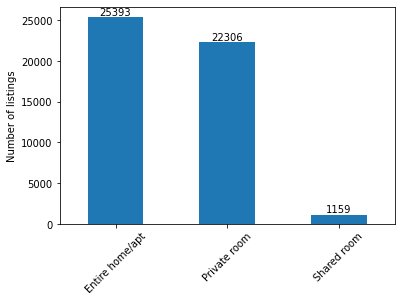

In [ ]:
#room-type counts graph
ax4 = data.room_type.value_counts().plot.bar(rot=45)
ax4.set_ylabel("Number of listings")
ax4.bar_label(ax4.containers[0])

We see maximum listings are either Private room or Entire home/apt

In [ ]:
#Avg. price and listings per neighbourhood_group(large area)
neighbourhood_group_df = data.groupby('neighbourhood_group').agg(avg_price=('price','mean'),
                       count=('price','count')).reset_index()
    
neighbourhood_group_df

,neighbourhood_group,avg_price,count
0,Bronx,87.469238,1089
1,Brooklyn,124.410523,20089
2,Manhattan,196.897473,21643
3,Queens,99.536017,5664
4,Staten Island,114.812332,373


Text(0, 0.5, '')

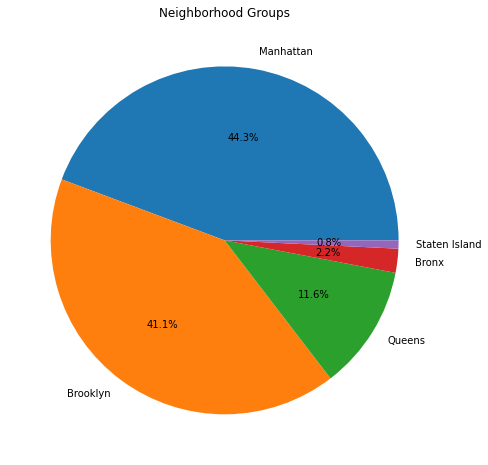

In [ ]:
#Pie chart to show listings in each neighbourhood group
ax1 = data.neighbourhood_group.value_counts().plot.pie(title='Neighborhood Groups',
                                               figsize=(8,8),
                                              autopct='%1.1f%%')
ax1.set_ylabel(None)

We see that more than 85% of listings are located in Manhattan and Brooklyn.

<AxesSubplot:xlabel='neighbourhood_group'>

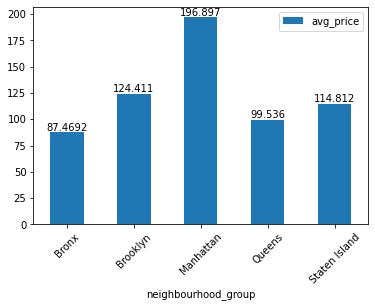

In [ ]:
ax4 = neighbourhood_group_df.plot.bar(rot=45, x='neighbourhood_group', y='avg_price')
ax4.bar_label(ax4.containers[0])
ax4

We see that highest average price is of listings are located in Manhattan

In [ ]:
data.groupby('neighbourhood').agg(avg_price=('price','mean'),
                       count=('price','count')).sort_values('count', ascending=False).reset_index()

,neighbourhood,avg_price,count
0,Williamsburg,143.826142,3917
1,Bedford-Stuyvesant,107.688392,3713
2,Harlem,118.952542,2655
3,Bushwick,84.815597,2462
4,Upper West Side,210.990350,1969
5,Hell's Kitchen,204.931934,1954
6,East Village,186.075594,1852
7,Upper East Side,188.872565,1797
8,Crown Heights,112.520154,1563
9,Midtown,282.719094,1545


In [ ]:
neighbourhood_df = data.groupby('neighbourhood', as_index=False)['price'].count()
neighbourhood_df = neighbourhood_df.rename(columns={'price':'count'})
neighbourhood_df

,neighbourhood,count
0,Allerton,42
1,Arden Heights,4
2,Arrochar,21
3,Arverne,77
4,Astoria,900
5,Bath Beach,17
6,Battery Park City,69
7,Bay Ridge,141
8,Bay Terrace,6
9,"Bay Terrace, Staten Island",2


In [ ]:
total_listings = len(data)
def others(row):
    if (row['count']/total_listings* 100) > 4.0:
        return False
    return True

# Apply the above function to create "Others" column
neighbourhood_df['Others'] = neighbourhood_df.apply(others, axis=1)
neighbourhood_df.head()

,neighbourhood,count,Others
0,Allerton,42,True
1,Arden Heights,4,True
2,Arrochar,21,True
3,Arverne,77,True
4,Astoria,900,True


In [ ]:
def map_others(row):
    if (row['Others'] == True):
        return "Other"
    return row['neighbourhood']

# Apply the above function to create "Others" column
neighbourhood_df['new_neighbourhood_value'] = neighbourhood_df.apply(map_others, axis=1)
len(neighbourhood_df)

NameError: ignored

In [ ]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
# Create a label encoder object
le = LabelEncoder()

In [ ]:
print(data.shape)
data.head()

(48858, 15)


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,0.00,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0


In [ ]:
# Label Encoding will be used for columns with 2 or less unique values
le_count = 0
for col in data.columns[1:]:
    if data[col].dtype == 'object':
        if len(list(data[col].unique())) <= 2:
            le.fit(data[col])
            data[col] = le.transform(data[col])
            le_count += 1
print('{} columns were label encoded.'.format(le_count))

0 columns were label encoded.


In [ ]:
# convert rest of categorical variable into dummy
data = pd.get_dummies(data, drop_first=True)

In [ ]:
print(data.shape)
data.head()

(48858, 59568)


,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,name_ 2-3 bedroom UWS garden triplex,name_ 3 bedroom loft in Williamsburg,name_ A charming Space in Brooklyn,name_ AMAZING TIME SQUARE!!BRICK WALLS!!,name_ Affordable & Cozy,name_ Beautiful Room In Gramercy!!!,name_ Family Friendly Brooklyn House,name_ Heart & Soul of Greenwich Village,"name_ Private 1 bdrm Lefferts Gr, BK apt",name_ Studio apartment in Greenpoint,name_ garden view / female guest,name_ quaint apartment with city views,"name_! ! ! Coliving: live, work, create","name_!! CLASSIC, LUXURY & CHARM !! By Central Park UWS",name_!!! Beautiful private room with backyard.,name_!!! Outpost Coliving . Shared twin room,name_!!!Co-Housing taken to the Next Level /Flatbush/2,name_!!!Living&Working. Beautiful Coliving on Flatbush,name_!!!Outpost Coliving . Flatbush. Cozy shared room,name_!!BEAUTIFUL APARTMENT WITH GARDEN!!,name_!!Cozy 3-person shared room near L train!!,name_!!Renovated shared room in great neighborhood!!,name_!!Studio next to Empire State Bldg.,name_!AMAZING PRIVATE ROOM 2 MIN FROM TRAIN STATION!,name_!Captivating Private Room,name_!PERFECT PRIVATE ROOM PLACE 2MIN FROM THE SUBWAY!,name_!Spacious & Modern Brooklyn Loft!,"name_""ADORABLE CENTRAL 1BD LITTLE ITALY/SOHO""","name_""Bloom of Floral Park"" 1 BR Basement Suite","name_""Borough Border Liner"" Diverse/Convenient/Private","name_""Bushwick in Manhattan"" Interactive, Private Room","name_""Cabin"" —Private Queen Bedroom in Jungly Apartment","name_""Central Park"" View Prvt Room,Mnh","name_""Chill"" Private 1BR Close to A,C,B,D,2,3","name_""Color Me Time Sq."" Interactive Room in Manhattan","name_""Cozy Retreat"" in North Crown Heights","name_""DECO CASA"" 2 Bedroom Greenpoint Brooklyn","name_""Dave's Island Suite""","name_""Desirable Deal on The Park""","name_""FALL IN LOVE WITH NYC & MY HOME""","name_""Gold Coast"" 1B in West Village w/ Back Yard","name_""Grandma Chic"" Brooklyn Apartment... Williamsburg","name_""HAPPYNEST"" CANARSIE","name_""HELLO BROOKLYN"" PARK SIDE VIEW NEWLY RENO APT.","name_""Home sweet Home :) ""","name_""Home sweet Home"" Welcome friends","name_""Hop and Skip to NYC""","name_""I LOVE BROOKLYN"" Newly Renovated Studio APT.","name_""In The Heights"" 2 Queen Beds in Huge Private Br.","name_""In The Heights"" King Br w/on-suite shared bath.","name_""In The Heights"" Luxurious triplex in historic TH","name_""In the Clouds"" Brooklyn Heights Studio","name_""In the Heights"" King Size Br w/shared baths.","name_""In the Heights"" Love: 2 Queen beds. beautiful br.","name_""MI Casa es su Casa ""","name_""Mi casa es su casa"" Welcome home","name_""Oasis on The Park""","name_""Off the Beaten Path"" NYC OASIS","name_""Quaint-Essential"" Living in the West Village","name_""San-Paraíso"" 80s curated Retro 3 Bedroom LES Pad","name_""Sea Gate"" Sunny, cozy, very clean studio app","name_""Simple Perfect Soho""","name_""Sweet Home near to Bronx Zoo in Little Italy ""","name_""THE MANHATTAN OASIS"" Penthouse & Private Terrace","name_""The Dumont"" Event Space","name_""The Grand Budapest"" room in Brooklyn!","name_""The Green Room"": Harlem Brownstone","name_""The Little House by the Sea""","name_""The Oasis"" on Bedford Williamsburg","name_""The Park View"" in Sunset Park","name_""The Spot""","name_""The Studio"" Harlem Brownstone","name_""The luxury of Comfort""","name_""The quick get Away #2""","name_""The quick get a way""","name_""Treehouse"" in the East Village with Private Patio","name_""WELCOME TO BROOKLYN"" PARK SIDE VIEW STUDIO APT","name_""Your home away from home #2",name_# 1 A Brooklyn New York Apt: close to metro subway,"name_# 1 B Brooklyn NYC Apt close to metro subway, JFK","name_# CENTRAL PARK - 3 stops away (32""TV room)",name_# TIMES SQUARE - 19 MinutesBIG ROOM,name_# sunny skylit sanctuary in the heart of BK! #,name_#1,name_#1 Spacious Private Room,name_#1 Hotel-Like Private Room King Bed Near JFK,

In [ ]:
#Feature scaling using MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 5))
data_col = list(data.columns)
data_col.remove('price')
for col in data_col:
    data[col] = data[col].astype(float)
    data[[col]] = scaler.fit_transform(data[[col]])
#data['price'] = pd.to_numeric(data['price'], downcast='float')
data.head()

In [ ]:
data['last_review'] = pd.to_datetime(data['last_review'])
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaT,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [ ]:
data[data['last_review'].isnull()][['number_of_reviews','reviews_per_month']]

,number_of_reviews,reviews_per_month
2,0,NaN
19,0,NaN
26,0,NaN
36,0,NaN
38,0,NaN
193,0,NaN
204,0,NaN
260,0,NaN
265,0,NaN
267,0,NaN


In [ ]:
#if a certain listing has a null for its "last_review," that means it has not gotten a review at all(also proved from previous dataframe), so "reviews_per_month" must be 0.
data.fillna({'reviews_per_month':0}, inplace=True)
data.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                     0
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [ ]:
df = data[['id','host_id','neighbourhood_group','neighbourhood', 
             'latitude', 'longitude', 'room_type', 'minimum_nights', 
             'number_of_reviews', 'reviews_per_month', 
             'calculated_host_listings_count', 'availability_365']]
df.head()

,id,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,1,9,0.21,6,365
1,2595,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,1,45,0.38,2,355
2,3647,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,3,0,0.00,1,365
3,3831,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,1,270,4.64,1,194
4,5022,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,10,9,0.10,1,0
